# Apartment Rent Dataset Classification

## Objective
Implement a data mining project using the Python machine learning library Spark MLlib to predict rental prices (`price`).  
Only Spark MLlib can be used for machine learning tasks, but non-ML libraries are allowed for other purposes.


## Data Source
[Kaggle: Apartment Rent Data](https://www.kaggle.com/datasets/shashanks1202/apartment-rent-data)
This dataset comprises detailed information on apartment rentals

This dataset comprises detailed information on apartment rentals:

- **Identifiers & Location:**  
  - Unique identifiers (`id`)
  - Geographic details (`address`, `cityname`, `state`, `latitude`, `longitude`)
  - Source of the classified listing (`source`)

- **Property Details:**  
  - Category (`category`)
  - Title (`title`)
  - Description (`body`)
  - Amenities (`amenities`)
  - Number of bathrooms (`bathrooms`)
  - Number of bedrooms (`bedrooms`)
  - Size of the apartment (`square_feet`)

- **Pricing Information:**  
  - Rental price (`price`)
  - Displayed price (`price_display`)
  - Price type (`price_type`)
  - Fee (`fee`)

- **Additional Features:**  
  - Photo availability (`has_photo`)
  - Pets allowed (`pets_allowed`)
  - Currency (`currency`)
  - Time of listing creation (`time`)

## Project Phases
1. **Discover and visualize the data**  
2. **Prepare the data for machine learning algorithms**  
3. **Select and train models**  
4. **Fine-tune the model**  
5. **Evaluate the outcomes**  

> **Note:**  
> You must repeat phases 3, 4, and 5 for at least three different models.

In [98]:
#!/usr/bin/env python3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')

# Load dataset
DATA_PATH = "./data/apartments_for_rent_classified_100K.csv"
df = pd.read_csv(DATA_PATH, delimiter=';', encoding='ISO-8859-1')
df.shape

/tmp/ipykernel_68/1453841023.py:11: DtypeWarning:

Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.



(99492, 22)

# (a) Discover and Visualize the Data  

## Dataset Structure Analysis

**Objective:** Understand data characteristics to inform preprocessing strategies.

### Key Analysis Areas
- **Data types and structure** - Feature characteristics and distributions
- **Missing data patterns** - Identify incomplete records and percentages  
- **Feature cardinality** - Assess uniqueness and dimensionality issues
- **Correlation analysis** - Examine relationships between numerical variables
- **Data quality issues** - Detect duplicates, outliers, and inconsistencies

In [99]:
# Understand structure and type of the data
# ------------------------------------------------------------------
summary = []
for col in df.columns:
    value_counts = df[col].value_counts().head(10)
    top_values = [str(x)[:50] for x in value_counts.index]  # Truncate long values
    summary.append({
        "Column": col,
        "Data Type": str(df[col].dtype),
        "Unique Values": df[col].nunique(),
        "Top 10 frequent Values (desc)": " | ".join(top_values)
    })

summary_df = pd.DataFrame(summary)
summary_df

,Column,Data Type,Unique Values,Top 10 frequent Values (desc)
0,id,int64,99408,5197858885 | 5197859052 | 5197859695 | 5197860...
1,category,object,7,housing/rent/apartment | housing/rent/commerci...
2,title,object,58503,Apartment in great location | Apartment in pri...
3,body,object,94503,"When searching for a pet-friendly One-, Two- a..."
4,amenities,object,9827,"Parking | Parking,Storage | Gym,Pool | Pool | ..."
5,bathrooms,float64,16,1.0 | 2.0 | 1.5 | 2.5 | 3.0 | 3.5 | 4.0 | 4.5 ...
6,bedrooms,float64,10,2.0 | 1.0 | 3.0 | 4.0 | 0.0 | 5.0 | 6.0 | 7.0 ...
7,currency,object,1,USD
8,fee,object,2,No | Yes
9,has_photo,object,3,Yes | Thumbnail | No


In [100]:
# Missing data %
# ------------------------------------------------------------------
pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
missing_values = (df.isnull().sum())/ (df.shape[0]) * 100
missing_values.loc[missing_values > 0].sort_values(ascending=False)

address         92.0164
pets_allowed    60.7325
amenities       16.1259
state            0.3035
cityname         0.3035
bedrooms         0.1246
bathrooms        0.0633
latitude         0.0251
longitude        0.0251
price_display    0.0010
price            0.0010
dtype: float64

In [101]:
# Determine cardinality of features (i.e the effective uniqueness)
# ------------------------------------------------------------------
import builtins
categorical_cols = [col for col in df.columns if col not in ['id','longitude','latitude','price','time','title','body','address','square_feet','price_display']]
max_len = builtins.max([len(c) for c in categorical_cols])
for col in categorical_cols:
    print(f"{col.ljust(max_len)} :{str(df[col].dtype).ljust(10)} : {str(df[col].nunique()).rjust(10)} unique values")

category     :object     :          7 unique values
amenities    :object     :       9827 unique values
bathrooms    :float64    :         16 unique values
bedrooms     :float64    :         10 unique values
currency     :object     :          1 unique values
fee          :object     :          2 unique values
has_photo    :object     :          3 unique values
pets_allowed :object     :          4 unique values
price_type   :object     :          3 unique values
cityname     :object     :       2979 unique values
state        :object     :         51 unique values
source       :object     :         25 unique values


In [102]:
# Check if identifier has duplicates
# ------------------------------------------------------------------
print(f"id has duplicates: {df['id'].duplicated().any()}")

id has duplicates: True


Text(0.5, 1.0, 'Correlation Matrix')

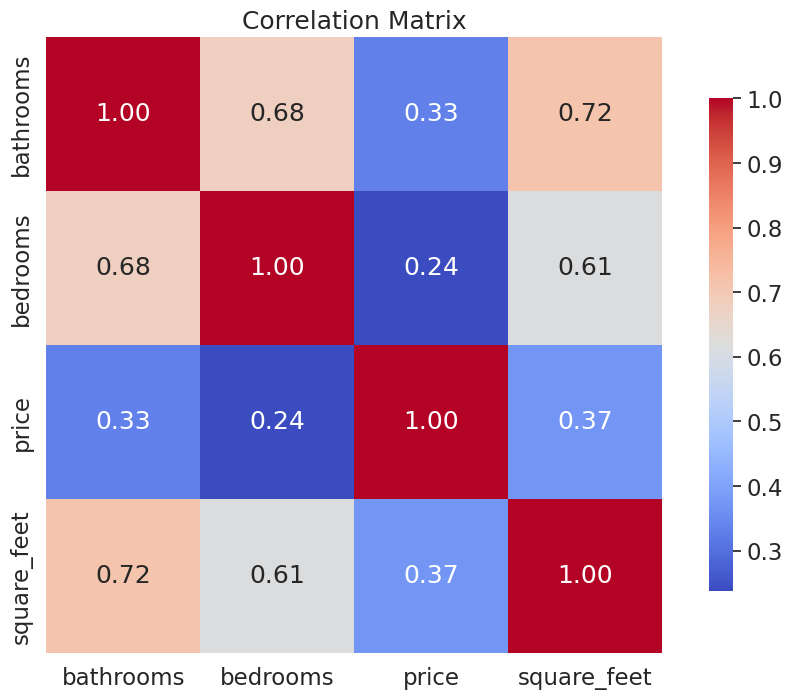

In [103]:
# Correlation analysis
# ------------------------------------------------------------------
correlation_matrix = df[['bathrooms', 'bedrooms', 'price', 'square_feet']].corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, cbar_kws={"shrink": .8})
plt.title('Correlation Matrix')

Sampled 5000 rows for pairplot visualization


<Figure size 1200x1000 with 0 Axes>

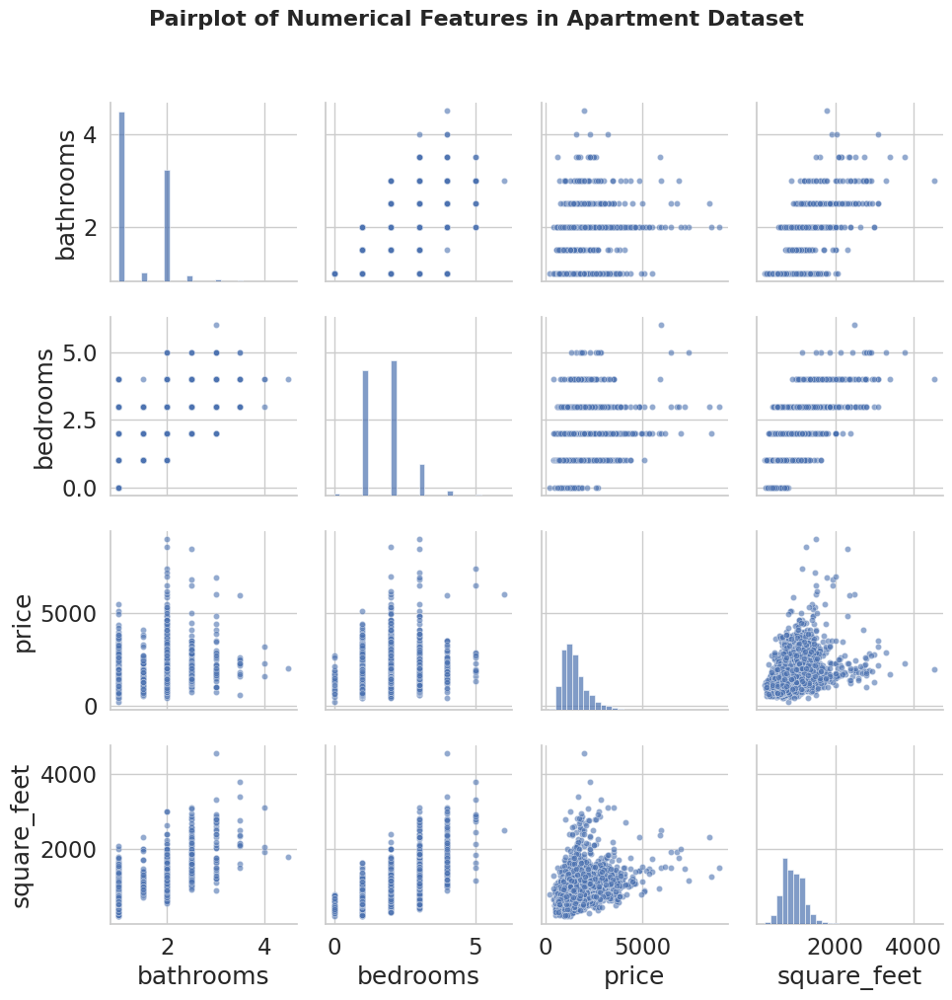


Correlation Matrix:
----------------------------------------
             bathrooms  bedrooms  price  square_feet
bathrooms         1.00      0.69   0.30         0.73
bedrooms          0.69      1.00   0.22         0.73
price             0.30      0.22   1.00         0.34
square_feet       0.73      0.73   0.34         1.00


In [ ]:
# Pairplot of numerical features
import seaborn as sns
import matplotlib.pyplot as plt

# Select numerical columns for pairplot
numerical_cols = ['bathrooms', 'bedrooms', 'price', 'square_feet']

# Create a subset of data for pairplot (sample for performance if dataset is large)
plot_df = df[numerical_cols].copy()

# Remove any rows with missing values
plot_df = plot_df.dropna()

# Sample data if dataset is too large (optional - for better performance)
if len(plot_df) > 5000:
    plot_df = plot_df.sample(n=5000, random_state=42)
    print(f"Sampled {len(plot_df)} rows for pairplot visualization")

# Create the pairplot
plt.figure(figsize=(12, 10))
pairplot = sns.pairplot(
    plot_df,
    diag_kind='hist',
    plot_kws={'alpha': 0.6, 's': 20},
    diag_kws={'bins': 30, 'alpha': 0.7}
)

# Customize the plot
pairplot.fig.suptitle('Pairplot of Numerical Features in Apartment Dataset',
                      fontsize=16, fontweight='bold', y=1.02)

# Improve layout
plt.tight_layout()
plt.show()

# Print correlation matrix for reference
print("\nCorrelation Matrix:")
print("-" * 40)
correlation_matrix = plot_df.corr()
print(correlation_matrix.round(3))

## Results of Analysis of the Structure and Content of Each Column

### Missing Values Analysis
There are missing values in the dataset, most notably for `address` where **92% of the values are missing**.

### Cardinality Assessment
We define **high cardinality** as a feature having more than 20 unique values. Looking at categorical features, we encounter significant cardinality issues:  

| Feature | Unique Values | Category | Issue Level |
|---------|---------------|----------|-------------|
| `amenities` | 9,827 | Very High | ⚠️ Critical |
| `cityname` | 2,979 | Very High | ⚠️ Critical |
| `source` | ~50+ | High | ⚠️ Moderate |
| `state` | ~50 | High | ⚠️ Moderate |

**Impact**: High cardinality features can lead to:
- Sparse feature matrices after one-hot encoding  
- Overfitting due to too many dimensions  
- Poor model generalization  

### Duplicate Values Detection
Duplicate values found in:  
- **Identifiers**: `id` field has duplicates  
- **Free text fields**: Both `title` and `body` contain duplicates  

---

## Analyzing The Distribution Of Values in The Dataset

### Analysis Methods
- **Bar graphs** of categorical features  
- **Box plots** of numeric features    
- **Histograms** of numeric features  

### Objectives
- 🎯 **Identify outliers** in numerical data  
- 📊 **Examine statistics** of numerical features (ranges, min/max values)  
- 📈 **Assess data distribution** - determine if values are well-spread or skewed  

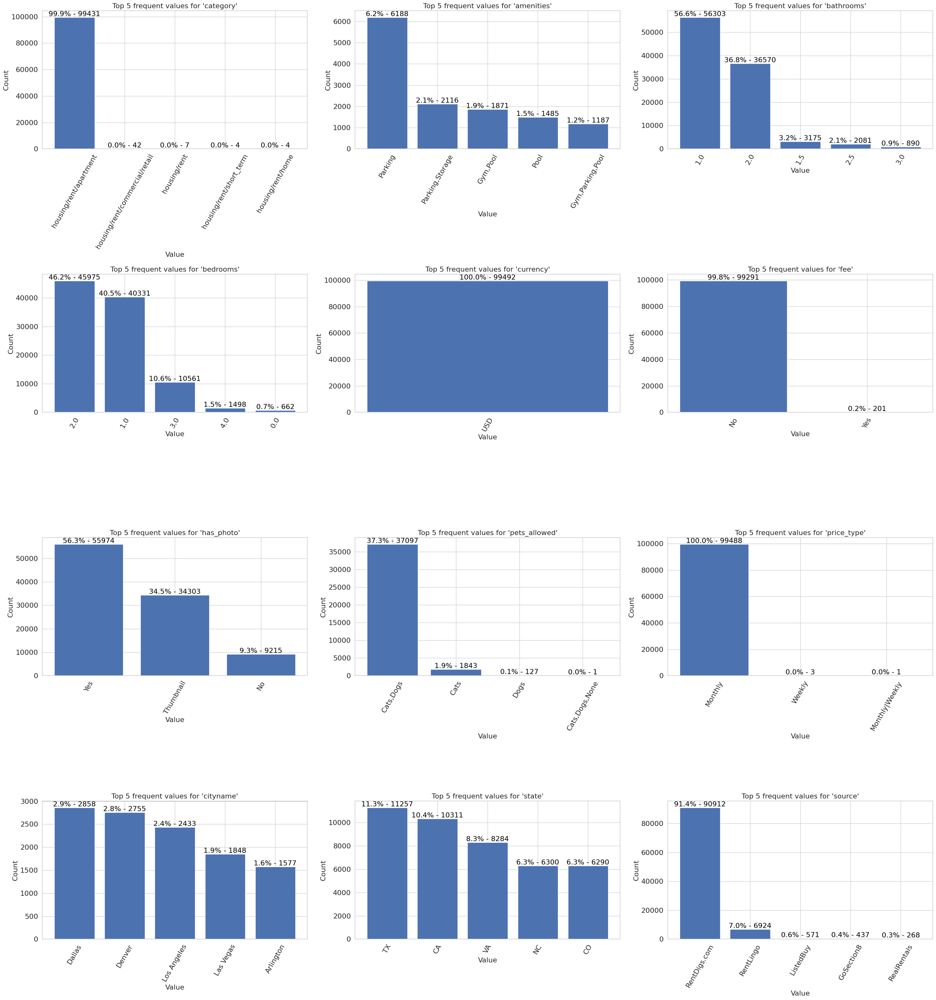

In [104]:
"""
Visualize the distribution of features in the dataset.
Also shows the percentage of the dataset that each value represents.
Only the top 5 most frequent values for each feature are plotted.
**This ignores null values, there are features where most of the values are null
"""

import math
# The following columns are ignored
columns_to_plot = [col for col in df.columns if col not in [
    'id', # Unique identifier, not useful for plotting
    'body', 'title', 'address', # Free text field
    'latitude', 'longitude', # GPS exact values, not useful for plotting
    'time','square_feet','price','price_display' # Numeric fields, not categorical
    ]]
num_cols = len(columns_to_plot)
cols_per_row = 3  # Fewer columns per row for more space
num_rows = math.ceil(num_cols / cols_per_row)

fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(cols_per_row*10, num_rows*8))
axes = axes.flatten()

for i, col in enumerate(columns_to_plot):
    value_counts = df[col].value_counts().head(5)
    total = len(df)
    unique_count = df[col].nunique()
    # Use a colormap for more colorful bars
    bars = axes[i].bar(value_counts.index.astype(str), value_counts.values)
    axes[i].set_title(f"Top 5 frequent values for '{col}'", fontsize=16)
    axes[i].set_xlabel("Value",fontsize=16)
    axes[i].set_ylabel("Count", fontsize=16)
    axes[i].tick_params(axis='x', rotation=60, labelsize=16)
    axes[i].tick_params(axis='y', labelsize=16)
    for bar, count in zip(bars, value_counts.values):
        percent = 100 * count / total
        axes[i].text(bar.get_x() + bar.get_width()/2, bar.get_height(), f"{percent:.1f}% - {count}",
                     ha='center', va='bottom', fontsize=16, color='black')

# Hide any unused subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

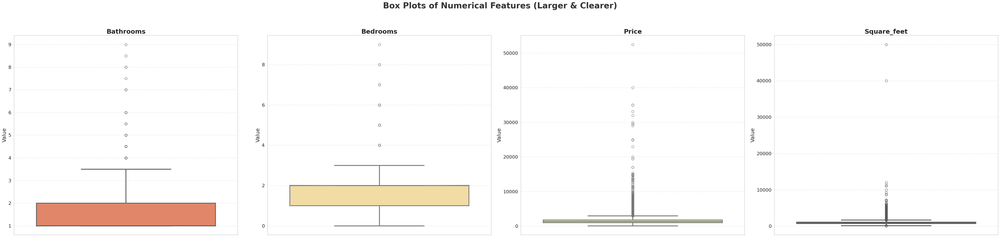

In [105]:
# Identifying outliers with larger, clearer boxplots

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

float_cols = ["bathrooms", "bedrooms", "price", "square_feet"]

sns.set(style="whitegrid", font_scale=1.5)
num_cols = len(float_cols)
fig, axes = plt.subplots(1, num_cols, figsize=(12*num_cols, 12), sharey=False)

for i, col in enumerate(float_cols):
    sns.boxplot(
        y=df[col],
        ax=axes[i],
        color=sns.color_palette("Spectral", num_cols)[i],
        notch=True,
        linewidth=3,
        fliersize=8,
        boxprops=dict(alpha=0.9)
    )
    axes[i].set_title(f"{col.capitalize()}", fontsize=22, weight='bold')
    axes[i].set_xlabel("")
    axes[i].set_ylabel("Value", fontsize=18)
    axes[i].grid(axis='y', linestyle='--', alpha=0.5)
    axes[i].tick_params(axis='y', labelsize=16)
    axes[i].tick_params(axis='x', labelsize=16)

plt.suptitle("Box Plots of Numerical Features (Larger & Clearer)", fontsize=28, weight='bold', color='#333333')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

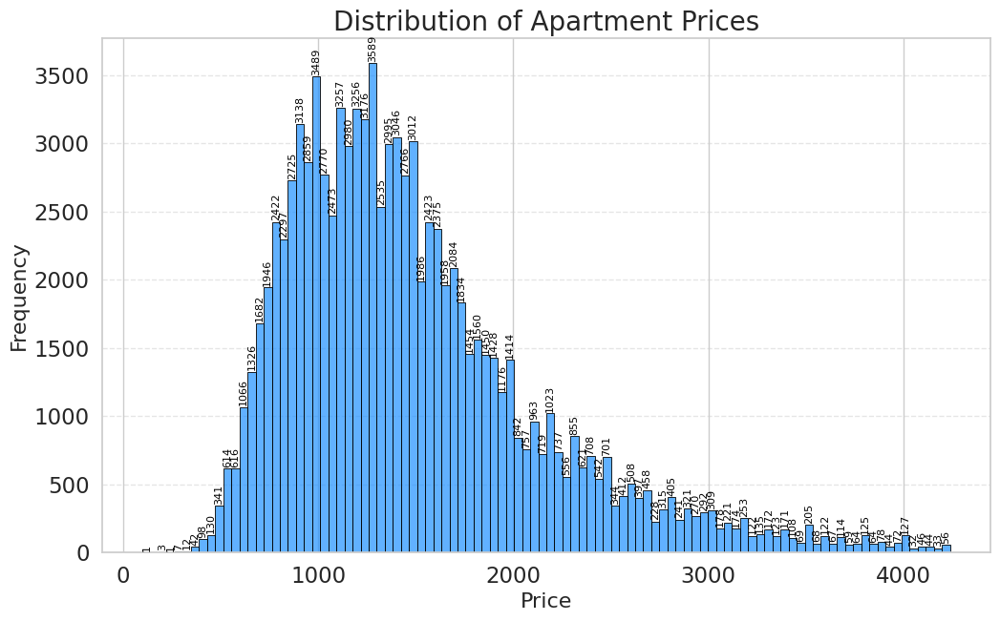

Price histogram: 98482 rows, 3298 unique prices
--------------------------------------------------
Price Statistics
count   99,491.00
mean     1,527.06
std        904.25
min        100.00
25%      1,013.00
50%      1,350.00
75%      1,795.00
max     52,500.00
Name: price, dtype: float64


In [106]:
# Histogram for price excluding outliers
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')
# Exclude outliers (5 std from mean)
mean_price = df['price'].mean()
std_price = df['price'].std()
lower_bound = mean_price - 3 * std_price
upper_bound = mean_price + 3 * std_price
price_histogram = df[(df['price'] >= lower_bound) & (df['price'] <= upper_bound)].copy(deep=True)


plt.figure(figsize=(12, 7))
ax = sns.histplot(
    price_histogram['price'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Prices', fontsize=20)
ax.set_xlabel('Price', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() +10),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

print(f"Price histogram: {len(price_histogram)} rows, {price_histogram['price'].nunique()} unique prices")
print('-' * 50)
print(f"Price Statistics")
print(df['price'].describe())

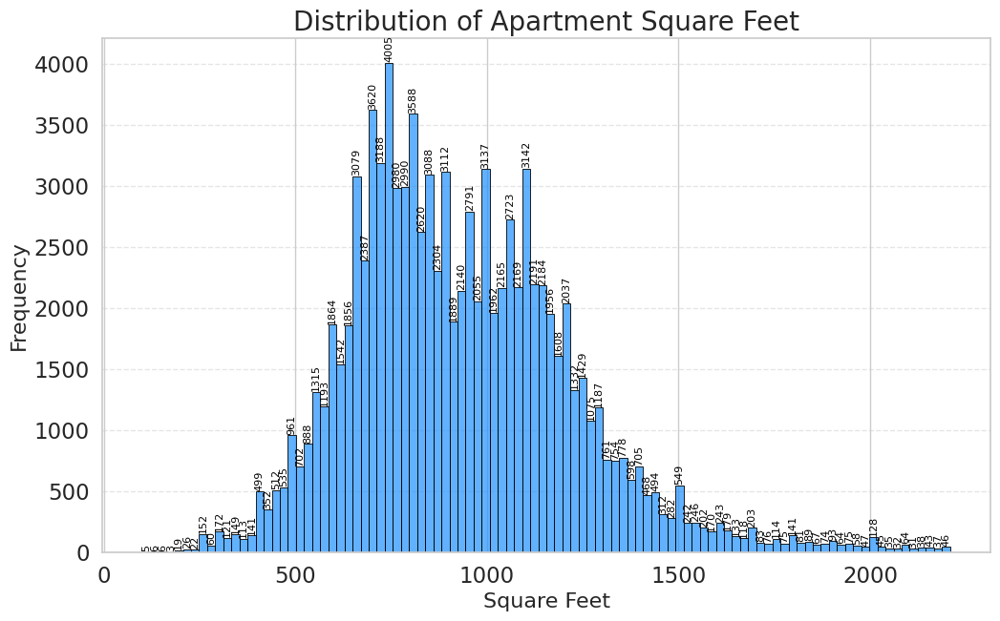

Square feet histogram: 98420 rows, 1875 unique square feet values
--------------------------------------------------
Square Feet Statistics
count   99,492.00
mean       956.43
std        417.57
min        101.00
25%        729.00
50%        900.00
75%      1,115.00
max     50,000.00
Name: square_feet, dtype: float64


In [107]:
# Histogram for square feet excluding outliers

# Exclude outliers (3 std from mean)
mean_sqft = df['square_feet'].mean()
std_sqft = df['square_feet'].std()
lower_bound = mean_sqft - 3 * std_sqft
upper_bound = mean_sqft + 3 * std_sqft
square_feet_histogram = df[(df['square_feet'] >= lower_bound) & (df['square_feet'] <= upper_bound)].copy(deep=True)

# graph
plt.figure(figsize=(12, 7))
ax = sns.histplot(
    square_feet_histogram['square_feet'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Square Feet', fontsize=20)
ax.set_xlabel('Square Feet', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count, with more vertical separation
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() + 5),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

# stats
print(f"Square feet histogram: {len(square_feet_histogram)} rows, {square_feet_histogram['square_feet'].nunique()} unique square feet values")
print('-' * 50)
print(f"Square Feet Statistics")
print(df['square_feet'].describe())

## Summary of Data Quality Issues and Preprocessing Concerns

### 🔍 **Duplicate Data Issues**
- **`id`** - Contains duplicate identifiers that need investigation  
- **`title`, `body`** - Free text fields with duplicates; need to determine if these are legitimate listings or cross-platform duplicates from different `source`   sites

### ⚖️ **Highly Skewed Features (Low Information Value)**
Features dominated by a single value (~90%+ of data):  
- **`category`** - 99.4% are "housing/rent/apartment"  
- **`currency`** - 100% are USD  
- **`fee`** - 99.8% are "No"  
- **`price_type`** - 99.9% are "Monthly"   
- **`source`** - 91.4% are from "RentDigs.com"  

*Impact: These features provide minimal predictive power due to lack of variance*

### 🎯 **Extreme Outliers**
Numerical features with extreme values requiring treatment:  
- **`price`** - Rental prices with unrealistic extremes  
- **`square_feet`** - Property sizes with outliers  
- **`bedrooms`** - Bedroom counts with extreme values  
- **`bathrooms`** - Bathroom counts with extreme values  

### 🗂️ **High Cardinality Features**
Features requiring dimensionality reduction:  
- **`amenities`** - 9,827 unique values (combinatorial explosion)  
- **`cityname`** - 2,979 unique cities  

### ❌ **Missing Data**
Features with significant missing values:  
- **`address`** - 92% missing (can be safely dropped)  
- **`pets_allowed`** - 60.7% missing  
- **`amenities`** - 16% missing   

### 🔧 **Processing Requirements**
- **`price_display`** - Redundant formatting of `price`, safe to drop  
- **`currency`** - All USD, safe to drop  
- **`title`, `body`** - Text features need processing or exclusion  
- **`latitude`, `longitude`** - Raw coordinates require transformation for usefulness  
- **Categorical features** - Require multi-value binarization (one-hot encoding)  

### 📈 **Rare Categories**  
- **`price_type`**, **`pets_allowed`** - Contain single-occurrence values that may cause issues  


## Key Dataset Insights
**Exploring geographic patterns, pricing trends, and market distribution across the US apartment rental market.**

In [108]:
# Imports for displaying graph images
import plotly.io as pio
from IPython.display import Image
render_images=False

In [109]:
# Geographical map
# Prepare data for mapping
geo_df = df.copy(deep=True)
geo_df = geo_df.dropna(subset=['latitude', 'longitude', 'price'])
geo_df["address"] = geo_df["address"].fillna('Not available')


fig = px.scatter_mapbox(
    geo_df,
    lat="latitude",
    lon="longitude",
    color="price",
    size="price",
    hover_name="title",
    hover_data=["address", "category", "source","state","cityname"],
    mapbox_style="carto-positron",
    zoom=3,
    color_continuous_scale=px.colors.sequential.Plasma,
    title="Geological Map of Apartment Prices"
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

/tmp/ipykernel_68/2639109610.py:8: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



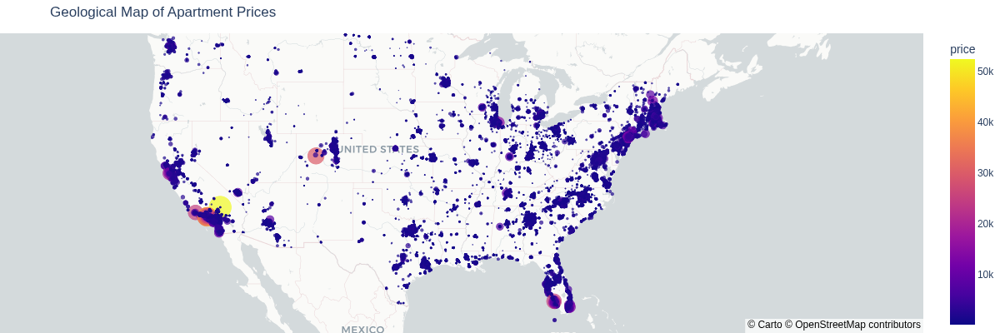

In [110]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
if render_images:
    pio.write_image(fig,"./images/geo_map_apartment_prices.png",width=1200, height=400)
Image("./images/geo_map_apartment_prices.png")

In [111]:
state_names = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas', 'CA': 'California',
    'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware', 'FL': 'Florida', 'GA': 'Georgia',
    'HI': 'Hawaii', 'ID': 'Idaho', 'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa',
    'KS': 'Kansas', 'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland',
    'MA': 'Massachusetts', 'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi', 'MO': 'Missouri',
    'MT': 'Montana', 'NE': 'Nebraska', 'NV': 'Nevada', 'NH': 'New Hampshire', 'NJ': 'New Jersey',
    'NM': 'New Mexico', 'NY': 'New York', 'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio',
    'OK': 'Oklahoma', 'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah', 'VT': 'Vermont',
    'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia', 'WI': 'Wisconsin', 'WY': 'Wyoming'
}

# Calculate median price per state
state_prices = df.groupby('state')['price'].median().sort_values()

# Get top 5 least and top 5 most expensive states
least_expensive = state_prices.head(5)
most_expensive = state_prices.tail(5)

# Combine for plotting
contrast_states = pd.concat([least_expensive, most_expensive]).reset_index()
contrast_states['State Name'] = contrast_states['state'].map(state_names)
contrast_states['Group'] = ['Least Expensive']*5 + ['Most Expensive']*5

fig = px.bar(
    contrast_states,
    x='price',
    y='State Name',
    color='Group',
    orientation='h',
    text='price',
    color_discrete_map={'Least Expensive': 'teal', 'Most Expensive': 'red'},
    title='Top 5 Least vs Most Expensive States (Median Apartment Price)'
)
fig.update_traces(texttemplate='$%{text:,.0f}', textposition='inside')
fig.update_layout(
    xaxis_title='Median Price (USD)',
    yaxis_title='State',
    yaxis=dict(categoryorder='total ascending'),
    legend_title='',
    font=dict(size=14),
)
fig.show()

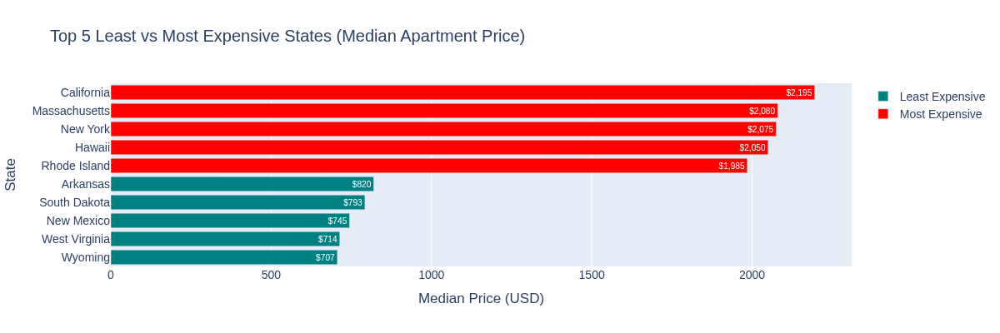

In [112]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
if render_images:
    pio.write_image(fig,"./images/top5_least_vs_most_expensive.png",width=1200, height=400)
Image("./images/top5_least_vs_most_expensive.png")

In [113]:
# Get visualization of top 10 states with the most listings
top_states = df["state"].value_counts().head(10).reset_index()
top_states.columns = ['state', 'count']  # Rename columns for clarity
top_states["state_name"] = top_states["state"].map(state_names)
fig = px.bar(
    top_states,
    x='count',
    y='state_name',
    orientation='h',
    title='Top 10 States with the Most Listings'
)
fig.update_layout(
    xaxis_title='Number Of Listings',
    yaxis_title='State Name',
    yaxis=dict(categoryorder='total ascending')
)
fig.show()

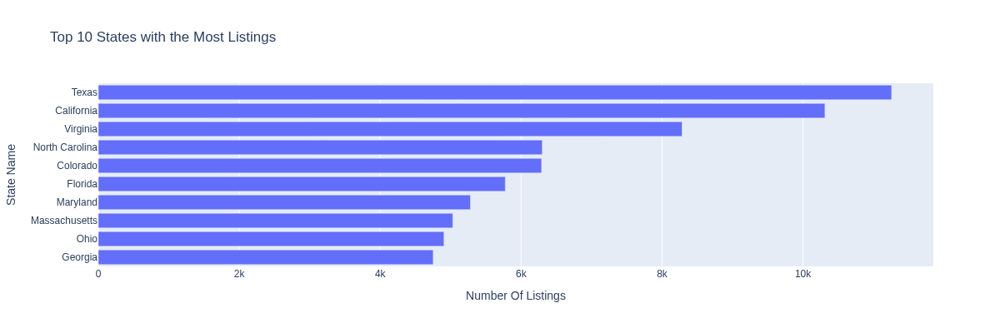

In [114]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
if render_images:
    pio.write_image(fig,"./images/top10_states_with_the_most_listings.png",width=1200, height=400)
Image("./images/top10_states_with_the_most_listings.png")

In [115]:
# Analysing how prices change over time per state (time intervals are in months)
df["time_readable"] = pd.to_datetime(df["time"], unit='s')
df["month"] = df["time_readable"].dt.to_period("M").astype(str)
top_states = df['state'].value_counts().head(10).index

# Group by state and month, get median price and count
plot_df = (
    df[df['state'].isin(top_states)]
    .groupby(['state', 'month'])
    .agg(price=('price', 'median'), count=('price', 'size'))
    .reset_index()
)

fig = px.line(
    plot_df,
    x='month',
    y='price',
    color='state',
    markers=True,
    title='Median Apartment Price by Month (Top 10 States)',
    labels={'month': 'Month', 'price': 'Median Price', 'state': 'State'},
    custom_data=['count']  # Set custom data here for hovertemplate
)

# Add sample count as hover info
fig.update_traces(
    hovertemplate=''
    '<b>%{x}</b>'
    '<br>Median Price: $%{y:,.0f}'
    '<br>Samples: %{customdata[0]}'
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()
# Investigating why california rose so much in this month
print(f"Sudden Spike in November for CA:")
print(
    df.loc[
        (df["month"] == "2019-11") &
        (df["state"] == "CA")
    ]["price"]
)


df.drop(["time_readable","month"],axis=1,inplace=True)
# Conclusion:
# State prices are mostly stable throughout the year in which this data was recorded

Sudden Spike in November for CA:
7123    9,450.00
51779     850.00
Name: price, dtype: float64


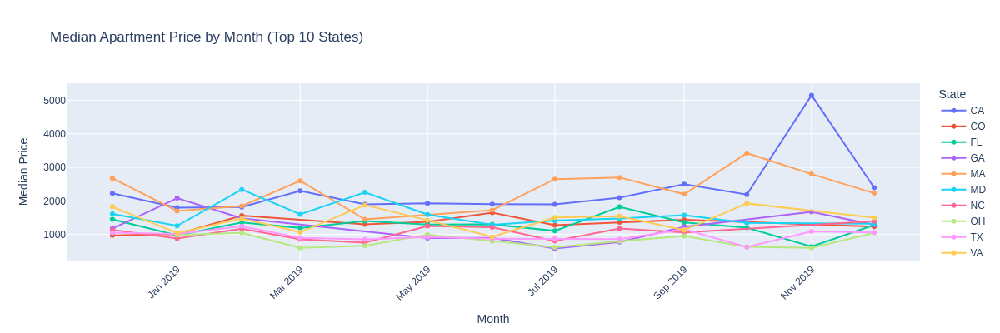

In [116]:
# Save the figure as an image & Display in report
# Note: This is done so the plotly graph is displayed in the exported pdf
# ----------------------------------------------------------------------
if render_images:
    pio.write_image(fig,"./images/median_price_by_month_top_10_states.png",width=1200, height=400)
Image("./images/median_price_by_month_top_10_states.png")

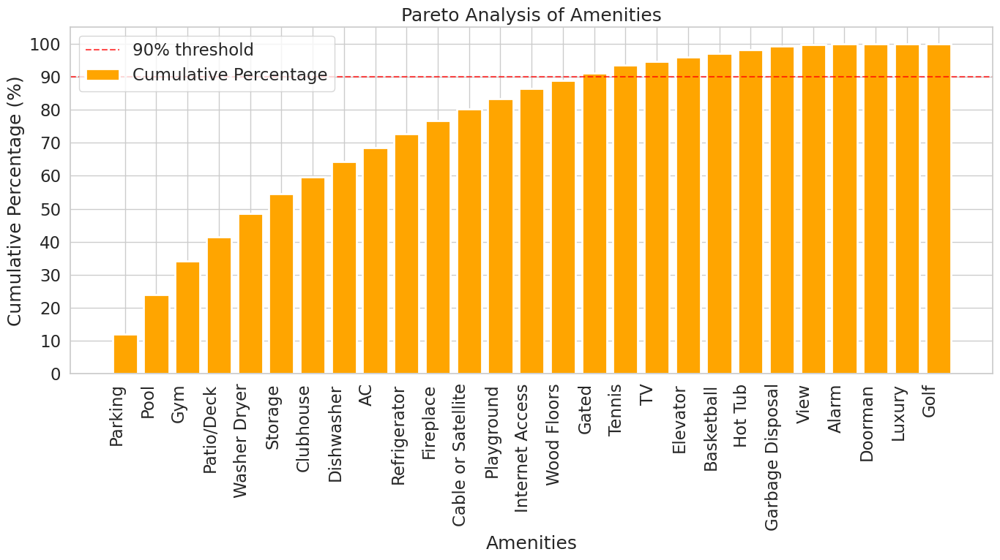

In [117]:
# Pareto analysis of amenities to identify the most common amenities
# ------------------------------------------------------------------
amenity_value_counts = df["amenities"].str.split(',').explode().value_counts()
amenity_value_counts = amenity_value_counts.reset_index()
amenity_value_counts["cumulative_count"] = amenity_value_counts["count"].cumsum().astype(int)
amenity_value_counts["cumulative_pct"] = (amenity_value_counts["cumulative_count"] / amenity_value_counts["count"].sum()) * 100
amenity_value_counts

# Plotting the Pareto chart for amenities
plt.figure(figsize=(14, 8))
plt.bar(
    amenity_value_counts["amenities"],
    amenity_value_counts["cumulative_pct"],
    color='orange',
    label='Cumulative Percentage',
    linewidth=2
)
plt.xlabel('Amenities')
plt.ylabel('Cumulative Percentage (%)')
plt.title('Pareto Analysis of Amenities')
plt.xticks(rotation=90, ha='right')

# Set y-axis to show in tens (10, 20, 30, etc.)
plt.yticks(range(0, 101, 10))  # 0, 10, 20, 30, ..., 100

# Add horizontal line at 90%
plt.axhline(y=90, color='red', linestyle='--', alpha=0.7, label='90% threshold')

plt.legend()
plt.tight_layout()
plt.show()


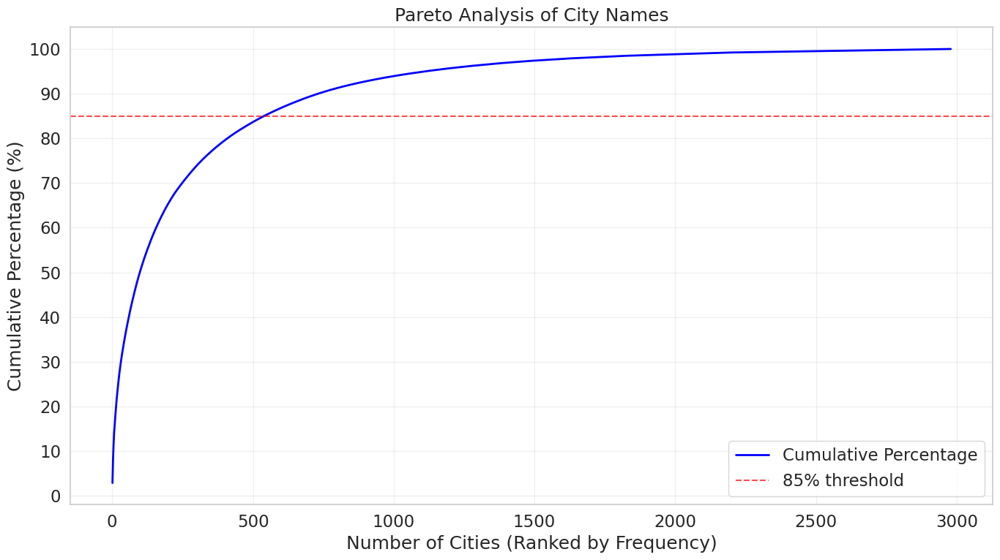

In [118]:
# Pareto analysis of cityname to identify the most common cities
# ------------------------------------------------------------------
cityname_counts = df["cityname"].value_counts().reset_index()
cityname_counts["cumulative_count"] = cityname_counts["count"].cumsum().astype(int)
cityname_counts["cumulative_pct"] = (cityname_counts["cumulative_count"] / cityname_counts["count"].sum()) * 100
cityname_counts.reset_index(inplace=True)
cityname_counts.columns = ["num_cities","cityname", "count", "cumulative_count", "cumulative_pct"]
cityname_counts["num_cities"] = cityname_counts["num_cities"] + 1  # Adjust index to start from 1


# Plotting the Pareto chart for city names as LINE PLOT
plt.figure(figsize=(14, 8))
plt.plot(
    cityname_counts["num_cities"],
    cityname_counts["cumulative_pct"],
    color='blue',
    markersize=3,
    linewidth=2,
    label='Cumulative Percentage'
)

plt.xlabel('Number of Cities (Ranked by Frequency)')
plt.ylabel('Cumulative Percentage (%)')
plt.title('Pareto Analysis of City Names')

# Set x-axis to show in ranges/intervals instead of individual city names
max_cities = len(cityname_counts)

# Set y-axis to show in tens (10, 20, 30, etc.)
plt.yticks(range(0, 101, 10))  # 0, 10, 20, 30, ..., 100

# Add horizontal line at 90%
plt.axhline(y=85, color='red', linestyle='--', alpha=0.7, label='85% threshold')

# Add grid for better readability
plt.grid(True, alpha=0.3)

plt.legend()
plt.tight_layout()
plt.show()


# (b) Prepare the data for machine learning algorithms

**Data preprocessing pipeline implemented using Spark MLlib to transform raw apartment rental data into ML-ready format.**

## 🎯 **Data Cleaning & Quality Issues**
- **Removed low-variance features**: Dropped columns with >90% single values (currency, category, fee, etc.)
- **Handled missing data**: Addressed 92% missing addresses and 60% missing pet policies  
- **Eliminated duplicates**: Cleaned duplicate IDs and redundant listings
- **Outlier treatment**: Applied IQR-based filtering to remove extreme values in price, bedrooms, bathrooms, and square footage

## 🔧 **Feature Engineering**
- **Geographic transformation**: Converted lat/lon coordinates into regional categories (northwest, northeast, southwest, southeast, central)
- **High cardinality reduction**: 
  - Amenities: Applied Pareto analysis (90% coverage) + one-hot encoding for top amenities
  - Cities: Reduced 2,979 cities to top 80% coverage + "other" category
- **New features**: Created `sqft_per_room` and interaction terms using RFormula
- **Text processing**: Excluded free-text fields (title, body) from current implementation

## ⚙️ **ML Pipeline Preparation**
- **Feature vectorization**: Used RFormula to create feature vectors with interaction terms:
  - `bedrooms:bathrooms`, `bedrooms:square_feet`, `bathrooms:square_feet`
- **Data scaling**: Applied StandardScaler for linear models while preserving tree-based model compatibility
- **Train/test split**: 80/20 split with both scaled and unscaled versions
- **Data persistence**: Saved preprocessed data as Parquet format for efficient reuse

In [119]:
# Initialize spark
from pyspark.sql import SparkSession
import psutil
import builtins

total_memory = psutil.virtual_memory().total // (1024**3)  # GB
cpu_cores = psutil.cpu_count()
print(f"Specs: {total_memory}GB RAM, {cpu_cores} CPU cores")

spark = SparkSession.builder \
    .appName("CSCI316-Task2-Optimized") \
    .config("spark.driver.memory", f"{builtins.min(total_memory-4, 20)}g") \
    .config("spark.driver.maxResultSize", "4g") \
    .config("spark.executor.memory", f"{builtins.min(total_memory-6, 16)}g") \
    .config("spark.executor.cores", str(builtins.min(cpu_cores-2, 6))) \
    .config("spark.default.parallelism", str(cpu_cores * 2)) \
    .config("spark.sql.adaptive.enabled", "true") \
    .config("spark.sql.adaptive.coalescePartitions.enabled", "true") \
    .config("spark.serializer", "org.apache.spark.serializer.KryoSerializer") \
    .config('spark.kryoserializer.buffer.max', '512m') \
    .getOrCreate()
# Check Spark UI URL and enable logging
print(f"Spark UI URL: {spark.sparkContext.uiWebUrl}")
print(f"Spark App ID: {spark.sparkContext.applicationId}")
print(f"Spark Master: {spark.sparkContext.master}")

# Enable more verbose logging for better progress tracking
spark.sparkContext.setLogLevel("INFO")


Specs: 19GB RAM, 16 CPU cores
Spark UI URL: http://3cc9776a9ec5:4040
Spark App ID: local-1755661658008
Spark Master: local[*]


In [120]:
from pyspark.ml import Pipeline, Transformer
from pyspark.ml.param.shared import HasInputCol, HasOutputCol, Param
from pyspark.ml.util import DefaultParamsReadable, DefaultParamsWritable
from pyspark.sql import DataFrame
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import RFormula, StandardScaler
from pyspark.sql.window import Window
from pyspark.ml import Estimator
import os

In [121]:
# Drop redundant columns, dominated/uninformative features
# --------------------------------------------------------
class DataCleaningTransformer(Transformer, HasInputCol, HasOutputCol, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for data cleaning operations"""

    def __init__(self,verbose=False):
        super(DataCleaningTransformer, self).__init__()
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Starting data cleaning transformation with dataset shape: ({dataset.count()}, {len(dataset.columns)})")

        # Handle duplicate IDs first
        # --------------------------------------------------------
        if self.verbose:
            print("Removing duplicate IDs...")

        # If 'id' column exists, remove duplicates based on 'id', keeping the first
        if "id" in dataset.columns:
            # Remove duplicates based on 'id', keeping the first occurrence
            if self.verbose:
                print(f"Initial dataset size: {dataset.count()} rows")

            dataset = dataset.dropDuplicates(["id"])

            if self.verbose:
                print(f"Dataset size after removing duplicates by 'id': {dataset.count()} rows")

        # Drop redundant columns
        # --------------------------------------------------------
        columns_to_drop = []
        # Same information as price
        if "price_display" in dataset.columns:
            columns_to_drop.append("price_display")

        # All rows are in USD
        if "currency" in dataset.columns:
            columns_to_drop.append("currency")

        # We will assume that all listings have category housing/rent/apartment for this implementation, will ignore every other data that has otherwise
        if "category" in dataset.columns:
            dataset = dataset.filter(dataset["category"] == "housing/rent/apartment")
            columns_to_drop.append("category")

        # We will assume that all listings do not have a fee for this implementation, will ignore every other data that has otherwise
        if "fee" in dataset.columns:
            dataset = dataset.filter(dataset["fee"] == "No")
            columns_to_drop.append("fee")

        # 91.4% of all sources are RentDigs.com, we can just drop this column then check if there are duplicate listings later on
        if "source" in dataset.columns:
            columns_to_drop.append("source")

        # We will assume that all price_types are monthly for this implementation, will ignore every other data that has otherwise
        if "price_type" in dataset.columns:
            dataset = dataset.filter(dataset["price_type"] == "Monthly")
            columns_to_drop.append("price_type")

        # time just shows when the listing was made, all the listings were recorded in the span of ~1 year
        if "time" in dataset.columns:
            columns_to_drop.append("time")

        # has_photo shows if listing has photos attached, will ignore this feature
        if "has_photo" in dataset.columns:
            columns_to_drop.append("has_photo")

        # address is a free text field that contains the address of the listing, we will ignore this feature as we are using other features for geographical information. FUrthermore, 92% of values do not have a populated address.
        if "address" in dataset.columns:
            columns_to_drop.append("address")

        # The body and title are free text fields, we will ignore them for this implementation
        if "body" in dataset.columns:
            columns_to_drop.append("body")

        if "title" in dataset.columns:
            columns_to_drop.append("title")

        if self.verbose:
            print(f"Dropping columns: {columns_to_drop}")
        dataset = dataset.drop(*columns_to_drop)

        # Handle missing values
        # --------------------------------------------------------
        if self.verbose:
            print("Handling missing values...")

        dataset = dataset.fillna({"pets_allowed": "none", "amenities": "none provided"})
        dataset = dataset.replace("NaN", "none", subset=["pets_allowed"])
        dataset = dataset.replace("", "none provided", subset=["amenities"])
        dataset = dataset.replace("NaN", "none provided", subset=["amenities"])
        dataset = dataset.replace("NaN", None, subset=["cityname","state"]) # Replace NaN with None for cityname and state

        # Other features have less than 1% of values missing we can drop these

        if self.verbose:
            print("Dropping rows with missing values in other features...")
            print(f"Initial dataset size before dropping missing values: {dataset.count()} rows")

        dataset = dataset.na.drop()

        if self.verbose:
            print(f"Final dataset size after cleaning: {dataset.count()} rows")
        if self.verbose:
            print(f"Final dataset shape after data cleaning transformation: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [122]:
# Geographic Transformer
# --------------------------------------------------------
class GeographicTransformer(Estimator, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for geographic data processing"""

    def __init__(self, verbose=False):
        super(GeographicTransformer, self).__init__()
        self.verbose = verbose

    def _fit(self, dataset: DataFrame):
        """Fit method to calculate geographic boundaries from training data"""
        if self.verbose:
            print(f"Starting geographic fitting with dataset shape: ({dataset.count()}, {len(dataset.columns)})")
            print("Calculating geographic boundaries from training data...")

        # Calculate boundaries from training data only
        lat_bounds = dataset.select(
            expr("percentile_approx(latitude, 0.33)").alias('lat_33'),
            expr("percentile_approx(latitude, 0.67)").alias('lat_67')
        ).collect()[0]

        lon_bounds = dataset.select(
            expr("percentile_approx(longitude, 0.33)").alias('lon_33'),
            expr("percentile_approx(longitude, 0.67)").alias('lon_67')
        ).collect()[0]

        if self.verbose:
            print(f"Fitted latitude bounds: 33rd percentile = {lat_bounds['lat_33']}, 67th percentile = {lat_bounds['lat_67']}")
            print(f"Fitted longitude bounds: 33rd percentile = {lon_bounds['lon_33']}, 67th percentile = {lon_bounds['lon_67']}")

        # Return a fitted model
        return GeographicTransformerModel(lat_bounds, lon_bounds, self.verbose)

class GeographicTransformerModel(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """Fitted Geographic Transformer Model"""

    def __init__(self, lat_bounds, lon_bounds, verbose=False):
        super(GeographicTransformerModel, self).__init__()
        self.lat_bounds = lat_bounds
        self.lon_bounds = lon_bounds
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Transforming geographic data using fitted boundaries...")

        lat_33, lat_67 = self.lat_bounds['lat_33'], self.lat_bounds['lat_67']
        lon_33, lon_67 = self.lon_bounds['lon_33'], self.lon_bounds['lon_67']

        # Create regional features using fitted boundaries
        dataset = dataset.withColumn(
            "resides_in",
            when((col("latitude") >= lat_67) & (col("longitude") <= lon_33), "northwest")
            .when((col("latitude") >= lat_67) & (col("longitude") >= lon_67), "northeast")
            .when((col("latitude") <= lat_33) & (col("longitude") <= lon_33), "southwest")
            .when((col("latitude") <= lat_33) & (col("longitude") >= lon_67), "southeast")
            .otherwise("central")
        )

        # Drop original latitude and longitude columns
        if self.verbose:
            print("Dropping original latitude and longitude columns...")
        dataset = dataset.drop("latitude", "longitude")

        if self.verbose:
            print(f"Final dataset shape after geographical transformation: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [123]:
# Pets Transformer
# --------------------------------------------------------
class PetsTransformer(Estimator, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for pets_allowed feature processing"""

    def __init__(self, verbose=False):
        super(PetsTransformer, self).__init__()
        self.verbose = verbose

    def _fit(self, dataset: DataFrame):
        """Fit method to determine pet types from training data"""
        if self.verbose:
            print(f"Starting pets_allowed fitting with dataset shape: ({dataset.count()}, {len(dataset.columns)})")
            print("Determining unique pet types from training data...")

        # Get unique pet types from training data
        pets_allowed_list = (
            dataset.select(explode(split(dataset.pets_allowed, ",")).alias("pet"))
            .distinct()
            .rdd.flatMap(lambda x: x)
            .collect()
        )
        pets_allowed_list = [pet.lower().strip() for pet in pets_allowed_list if pet.lower().strip() != "none"]

        if self.verbose:
            print(f"Fitted pet types: {pets_allowed_list}")
            print(f"Total unique pet types: {len(pets_allowed_list)}")

        return PetsTransformerModel(pets_allowed_list, self.verbose)

class PetsTransformerModel(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """Fitted Pets Transformer Model"""

    def __init__(self, pets_allowed_list, verbose=False):
        super(PetsTransformerModel, self).__init__()
        self.pets_allowed_list = pets_allowed_list
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Transforming pets_allowed using fitted pet types...")

        # Create binary columns for each pet type from fitted list
        for pet in self.pets_allowed_list:
            if pet != "none":
                dataset = dataset.withColumn(
                    f"allows_{pet}",
                    when(col("pets_allowed").contains(pet.strip()), 1).otherwise(0)
                )

        # Drop the original pets_allowed column
        if self.verbose:
            print("Dropping original pets_allowed column...")
        dataset = dataset.drop("pets_allowed")

        if self.verbose:
            print(f"Final dataset shape after pets_allowed transformation: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [124]:
# Amenities Transformer
# --------------------------------------------------------
class AmenitiesTransformer(Estimator, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for amenities feature processing"""

    def __init__(self, verbose=False):
        super(AmenitiesTransformer, self).__init__()
        self.verbose = verbose

    def _fit(self, dataset: DataFrame):
        """Fit method to determine amenities from training data"""
        # explode amenities and count them
        amenities_exploded = dataset.select(explode(split(dataset.amenities, ",")).alias('amenity'))
        amenity_counts = (
            amenities_exploded
            .filter(col('amenity') != "None provided")
            .groupBy('amenity')
            .agg(count("*").alias("count"))
            .orderBy('count', ascending=False)
        )

        # Pareto analysis
        total_count = amenity_counts.agg(sum("count")).collect()[0][0]
        window_spec = Window.orderBy(col("count").desc()).rowsBetween(Window.unboundedPreceding, Window.currentRow)
        amenity_counts_with_cumsum = amenity_counts\
            .withColumn("cumulative_count", sum("count").over(window_spec))\
            .withColumn("cumulative_pct", (col("cumulative_count") / total_count) * 100)

        # Get amenities that account for 90% of all mentions
        amenities_90pct = amenity_counts_with_cumsum.filter(col("cumulative_pct") <= 90)

        # Store the amenity list for consistent transformation
        amenity_list = [row['amenity'] for row in amenities_90pct.select("amenity").collect() if row['amenity'] != "none provided"]

        if self.verbose:
            print(f"Fitted amenities transformer with {len(amenity_list)} amenities")

        return AmenitiesTransformerModel(amenity_list, self.verbose)

class AmenitiesTransformerModel(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """Fitted Amenities Transformer Model"""

    def __init__(self, amenity_list, verbose=False):
        super(AmenitiesTransformerModel, self).__init__()
        self.amenity_list = amenity_list
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Transforming amenities using fitted amenity list: {self.amenity_list}")

        # Create binary columns for each amenity in the fitted list
        for amenity in self.amenity_list:
            dataset = dataset.withColumn(
                f"has_{amenity.lower().strip()}",
                when(col("amenities").contains(amenity.strip()), 1).otherwise(0)
            )

        # Create "other" amenities column
        amenity_set = set([a.lower().strip() for a in self.amenity_list])
        def has_other_amenities(amenities_str):
            if amenities_str == "None provided":
                return 0
            items = [a.lower().strip() for a in amenities_str.split(",")]
            return int(any(a not in amenity_set for a in items))

        has_other_udf = udf(has_other_amenities, IntegerType())
        dataset = dataset.withColumn("has_other", has_other_udf(col("amenities")))

        dataset = dataset.drop("amenities")
        return dataset

In [125]:
# City Transformer
# --------------------------------------------------------
class CityTransformer(Estimator, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for cityname feature processing"""

    def __init__(self, verbose=False):
        super(CityTransformer, self).__init__()
        self.verbose = verbose

    def _fit(self, dataset: DataFrame):
        """Fit method for cityname"""
        if self.verbose:
            print(f"Starting cityname transformation with dataset shape: ({dataset.count()}, {len(dataset.columns)})")
            print("Performing Pareto analysis on city names...")

        # Get city counts and apply pareto analysis
        city_counts = dataset.groupBy('cityname').count().orderBy('count', ascending=False)
        total_count = city_counts.agg(sum("count")).collect()[0][0]
        window_spec = Window.orderBy(col("count").desc()).rowsBetween(Window.unboundedPreceding, Window.currentRow)
        city_counts_with_cumsum = city_counts\
            .withColumn("cumulative_count", sum("count").over(window_spec))\
            .withColumn("cumulative_pct", (col("cumulative_count") / total_count) * 100)

        # Get cities that account for 85% of all mentions
        cities_85pct = city_counts_with_cumsum.filter(col("cumulative_pct") <= 85)

        if self.verbose:
            print(f"Total cities accounting for 85% of mentions: {cities_85pct.count()}")
        # Collect the city list
        city_list = [row['cityname'] for row in cities_85pct.select("cityname").collect()]

        return CityTransformerModel(city_list, self.verbose)

class CityTransformerModel(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """Fitted City Transformer Model"""

    def __init__(self, city_list, verbose=False):
        super(CityTransformerModel, self).__init__()
        self.city_list = city_list
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Changing cities not in the top 85% to 'other'...")
        dataset = dataset.withColumn(
            "cityname",
            when(col("cityname").isin(self.city_list), col("cityname")).otherwise("other")
        )
        if self.verbose:
            print(f"Final dataset shape after cityname transformation: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [126]:
# Fix OutlierRemovalTransformer to properly implement Estimator interface
class OutlierRemovalTransformer(Estimator, DefaultParamsReadable, DefaultParamsWritable):
    """Custom transformer for outlier removal based on IQR"""

    def __init__(self, verbose=False):
        super(OutlierRemovalTransformer, self).__init__()
        self.verbose = verbose

    def _fit(self, dataset: DataFrame):
        """Fit method to calculate outlier bounds from training data"""
        if self.verbose:
            print(f"Starting outlier bounds fitting with dataset shape: ({dataset.count()}, {len(dataset.columns)})")
            print("Calculating outlier bounds from training data...")

        outlier_cols = ["bathrooms", "bedrooms", "price", "square_feet"]
        bounds = {}

        for col_name in outlier_cols:
            quantiles = dataset.select(
                expr(f"percentile_approx({col_name}, 0.25)").alias('Q1'),
                expr(f"percentile_approx({col_name}, 0.75)").alias('Q3')
            ).collect()[0]

            Q1 = quantiles['Q1']
            Q3 = quantiles['Q3']
            IQR = Q3 - Q1

            lower_bound = Q1 - 3 * IQR
            upper_bound = Q3 + 3 * IQR

            bounds[col_name] = {'lower': lower_bound, 'upper': upper_bound}

            if self.verbose:
                print(f"Fitted bounds for {col_name}: [{lower_bound:.2f}, {upper_bound:.2f}]")

        return OutlierRemovalTransformerModel(bounds, self.verbose)

class OutlierRemovalTransformerModel(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """Fitted Outlier Removal Transformer Model"""

    def __init__(self, outlier_bounds, verbose=False):
        super(OutlierRemovalTransformerModel, self).__init__()
        self.outlier_bounds = outlier_bounds
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Removing outliers using fitted bounds...")

        # Apply fitted bounds to remove outliers
        for col_name, bounds in self.outlier_bounds.items():
            if self.verbose:
                print(f"Filtering {col_name} with bounds [{bounds['lower']:.2f}, {bounds['upper']:.2f}]")

            dataset = dataset.filter(
                (col(col_name) >= bounds['lower']) &
                (col(col_name) <= bounds['upper'])
            )

        if self.verbose:
            print(f"Final dataset shape after outlier removal: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [127]:
class FeatureEngineeringTransformer(Transformer, DefaultParamsReadable, DefaultParamsWritable):
    """
    Custom transformer for feature engineering.
    Purely deterministic transformation that creates new features.
    """

    def __init__(self, verbose=False):
        super(FeatureEngineeringTransformer, self).__init__()
        self.verbose = verbose

    def _transform(self, dataset: DataFrame) -> DataFrame:
        if self.verbose:
            print(f"Starting feature engineering transformation with dataset shape: ({dataset.count()}, {len(dataset.columns)})")
            print("Creating new features...")


        # Create a new feature: sqft_per_room
        if self.verbose:
            print("Creating sqft_per_room feature...")
        dataset = dataset.withColumn(
            "sqft_per_room",
            when(col("bedrooms") > 0, col("square_feet") / col("bedrooms")).otherwise(0)
        )

        if self.verbose:
            print(f"Dropping id column if it exists...")
        if "id" in dataset.columns:
            dataset = dataset.drop("id")


        if self.verbose:
            print(f"Final dataset shape after feature engineering transformation: ({dataset.count()}, {len(dataset.columns)})")
        return dataset

In [128]:
def create_safe_preprocessing_pipeline():
    """
    Create a preprocessing pipeline with transformers that do not use any of the data statistics.
    This is a measure for preventing data leakage.
    """

    pipeline = Pipeline(stages=[
        DataCleaningTransformer(verbose=True)
        ])
    return pipeline

def create_preprocessing_pipeline():
    """
    Create a preprocessing pipeline with the custom transformers that use data statistics.
    This is a measure for preventing data leakage.
    """
    return Pipeline(stages=[
        GeographicTransformer(verbose=True),
        PetsTransformer(verbose=True),
        AmenitiesTransformer(verbose=True),
        CityTransformer(verbose=True),
        OutlierRemovalTransformer(verbose=True),
        FeatureEngineeringTransformer(verbose=True),
        # Apply RFormula to create features and label
        RFormula(
        formula="""price ~ . +
        bedrooms:bathrooms +
        bedrooms:square_feet +
        bathrooms:square_feet
        """,
        featuresCol="features",
        labelCol="label"),
        # Scale the features
        StandardScaler(
        inputCol="features",
        outputCol="scaled_features",
        withMean=True,
        withStd=True
        )
    ])

In [129]:
def preprocess_data(spark,df):
    """
    Run the preprocessing pipeline on the given DataFrame.
    This function will apply the preprocessing steps defined in the pipeline.
    """
    # Create a Spark DataFrame from the pandas DataFrame
    data = spark.createDataFrame(df)

    # Clean the data: Apply transformers that do not use statistics
    clean_data = create_safe_preprocessing_pipeline().fit(data).transform(data)

    # Split the data
    train_data, test_data = clean_data.randomSplit([0.8, 0.2], seed=170121)

    # Preprocess the data: Apply transformers that use statistics
    preprocess_pipeline = create_preprocessing_pipeline()
    print(f"\n\nFitting Preprocessing Pipeline on Train data...")
    fitted_pipeline = preprocess_pipeline.fit(train_data)
    print(f"\n\nTransforming Train data...")
    processed_scaled_train_data = fitted_pipeline.transform(train_data)
    print(f"\n\nTransforming Test data...")
    processed_scaled_test_data = fitted_pipeline.transform(test_data)

    # Save models and data
    os.makedirs("./models", exist_ok=True)
    os.makedirs("./data", exist_ok=True)

    print(f"Saving preprocessing pipeline...")
    fitted_pipeline.write().overwrite().save("./models/preprocessing_pipeline")

    print(f"Saving processed and scaled data to Parquet files...")
    processed_scaled_train_data.write.mode("overwrite").parquet("./data/scaled_train_data.parquet")
    processed_scaled_test_data.write.mode("overwrite").parquet("./data/scaled_test_data.parquet")

    print(f"\n\nPreprocessing complete. Processed and scaled data is saved to Parquet files.")
    return {
        "train_data": processed_scaled_train_data,
        "test_data": processed_scaled_test_data
    }

In [130]:
processed_data = preprocess_data(spark,df)
print(f"Processed train data shape: {processed_data['train_data'].count()}, {len(processed_data['train_data'].columns)}")
print(f"Processed test data shape: {processed_data['test_data'].count()}, {len(processed_data['test_data'].columns)}")

Starting data cleaning transformation with dataset shape: (99492, 22)
Removing duplicate IDs...
Initial dataset size: 99492 rows
Dataset size after removing duplicates by 'id': 99408 rows
Dropping columns: ['price_display', 'currency', 'category', 'fee', 'source', 'price_type', 'time', 'has_photo', 'address', 'body', 'title']
Handling missing values...
Dropping rows with missing values in other features...
Initial dataset size before dropping missing values: 99142 rows
Final dataset size after cleaning: 98663 rows
Final dataset shape after data cleaning transformation: (98663, 11)


Fitting Preprocessing Pipeline on Train data...
Starting geographic fitting with dataset shape: (78982, 11)
Calculating geographic boundaries from training data...
Fitted latitude bounds: 33rd percentile = 34.0899, 67th percentile = 39.3191
Fitted longitude bounds: 33rd percentile = -96.8406, 67th percentile = -80.806
Transforming geographic data using fitted boundaries...
Dropping original latitude and lon

# (c) & (d) Select and Train model

Pipeline
- Load the data
- Split the data into train_data and test_data
- Define a scaler and fit scaler to train_data
- Use scaler to transform both train_data and test_data to create scaled_train_data and scaled_test_data

We will have a non-scaled and scaled train_data and test_data as some of the models do not require scaled data whereas, others perform better when fitted to scaled data.


In [131]:
from pyspark.ml.feature import StandardScaler, VectorAssembler
from pyspark.ml import Pipeline
import os

# Load data
train_data = spark.read.parquet("./data/scaled_train_data.parquet")
test_data = spark.read.parquet("./data/scaled_test_data.parquet")

## Model 1: Gradient Boosted Trees (GBT)

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options           | Description                                                                 |
|---------------------|-------------------|-----------------------------------------------------------------------------|
| **maxIter**         | 200     | Number of boosting iterations (trees) in the ensemble                       |
| **maxDepth**        | 6, 8        | Maximum depth of each individual tree                                       |
| **stepSize**        | 0.1, 0.15   | Learning rate; how much each tree contributes to the final prediction       |

#### Parameter Details

- **maxIter**: Number of boosting iterations (trees) in the ensemble.  
  *Higher values increase model complexity and training time significantly, but may improve accuracy.*

- **maxDepth**: Maximum depth of each individual tree.  
  *Deeper trees can capture more complex patterns but risk overfitting.*

- **stepSize**: Learning rate, controlling how much each tree contributes to the final prediction.  
  *Lower values make learning more gradual and stable, but require more iterations.*

- **subsamplingRate**: Fraction of training data randomly sampled for each tree.  
  *Lower values introduce more randomness, which can help prevent overfitting and improve generalization.*

> **Note:** This grid search will train 4 (1x2x2) parameter combinations. With 3-fold cross-validation, a total of 12 models will be trained. 

---

### 🔁 3-Fold Cross Validation

- The dataset is split into 3 equal folds.
- For each run, the model is trained on 2 folds and tested on the remaining fold.
- This process repeats 3 times, each time with a different fold as the test set.
- The final performance metric is the average of the 3 test results.

In [132]:
from pyspark.ml.regression import GBTRegressor, GBTRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel
import builtins

# GBT with hyperparameter tuning
gbt = GBTRegressor(
    featuresCol="features",
    labelCol="label",
    predictionCol="prediction",
    subsamplingRate=0.7,  # Use 70% of data for each tree
    seed=42
)

# Hyperparameter grid
param_grid = ParamGridBuilder() \
    .addGrid(gbt.maxIter, [200]) \
    .addGrid(gbt.maxDepth, [6,8]) \
    .addGrid(gbt.stepSize, [0.1,0.15]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=gbt,
    estimatorParamMaps=param_grid,
    evaluator=RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds=3,
    parallelism=builtins.min(cpu_cores-1, 6),
    seed=42
)

model_path = "./models/gbt_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"gbt_best_model")) or retrain:
    print("Training GBT with Cross Validation...")
    cv_model = cv.fit(train_data)
    gbt_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained GBT model...")
    gbt_best_model = GBTRegressionModel.load(os.path.join(model_path,"gbt_best_model"))
    print(f"Loaded model with paremeters: ")


print(f"maxIter: {gbt_best_model.getMaxIter()}")
print(f"maxDepth: {gbt_best_model.getMaxDepth()}")
print(f"stepSize: {gbt_best_model.getStepSize()}")
print(f"subsamplingRate: {gbt_best_model.getSubsamplingRate()}")

gbt_train_predictions = gbt_best_model.transform(train_data)
gbt_test_predictions = gbt_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_gbt = pd.DataFrame(performance_data)
print(f"\nGBT Model Performance (Best Parameters):")
print(performance_df_gbt)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"gbt_best_model")) or retrain:
    print(f"Saving the best GBT model to {os.path.join(model_path,'gbt_best_model')}")
    gbt_best_model.write().overwrite().save(os.path.join(model_path,"gbt_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained GBT model...
Loaded model with paremeters: 
maxIter: 200
maxDepth: 8
stepSize: 0.15
subsamplingRate: 0.7

GBT Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  239.43  290.01
1          MAE  164.94  196.36
2           R²  0.8570  0.7913
3  Sample Size   77468   19326


## Model 2: Linear Regression

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options              | Description                                                                 |
|---------------------|----------------------|-----------------------------------------------------------------------------|
| **regParam**        | 0.01, 0.05, 0.1            | L2 regularization parameter (Ridge penalty)                                |
| **elasticNetParam** | 0.1, 0.5, 1.0             | Elastic net mixing parameter (0=L2, 1=L1, 0.5=balanced)                  |
| **maxIter**         | 100, 200, 500, 600             | Maximum number of iterations for optimization                               |

#### Parameter Details

- **regParam**: L2 regularization parameter to prevent overfitting.  
  *Higher values add more penalty to large coefficients, reducing model complexity.*

- **elasticNetParam**: Controls the balance between L1 (Lasso) and L2 (Ridge) regularization.  
  *0.5 = balanced elastic net, 1.0 = pure Lasso regression (L1 only).*

- **maxIter**: Maximum iterations for the optimization algorithm.  
  *Higher values allow more time for convergence but increase training time.*

> **Note:** Linear regression benefits greatly from feature scaling. We use the scaled features for optimal performance.

---

### 🔁 3-Fold Cross Validation

- Uses scaled features for better convergence and performance
- Tests different regularization strategies to prevent overfitting
- Evaluates on RMSE metric to select the best hyperparameter combination
- This grid search will train 36 parameter combinations (3x3x4) with 3-fold CV = 108 models total

In [133]:
from pyspark.ml.regression import LinearRegression, LinearRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel
import builtins

# Define model
lr = LinearRegression(
    featuresCol = "scaled_features",
    labelCol="label",
    predictionCol="prediction"
)

param_grid = ParamGridBuilder() \
    .addGrid(lr.regParam, [0.01, 0.05 ,0.1]) \
    .addGrid(lr.elasticNetParam,[0.1,0.5,1.0])\
    .addGrid(lr.maxIter, [100,200,500,600]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=lr,
    estimatorParamMaps = param_grid,
    evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds =3,
    parallelism=builtins.min(cpu_cores-1, 6),
    seed = 24
)

model_path = "./models/linear_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"lr_best_model")) or retrain:
    print("Training Linear Regression with Cross Validation...")
    cv_model = cv.fit(train_data)
    lr_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained LR model ...")
    lr_best_model = LinearRegressionModel.load(os.path.join(model_path,"lr_best_model"))

if os.path.exists(os.path.join(model_path,"cv_model")):
    print("Loading CV model...")
    cv_model = CrossValidatorModel.load(os.path.join(model_path,"cv_model"))
    print("Loaded CV model.")

print(f"regParam (L2 penalty): {lr_best_model.getRegParam()}")
print(f"elasticNetParam (L1/L2 mix): {lr_best_model.getElasticNetParam()}")
print(f"maxIter: {lr_best_model.getMaxIter()}")

lr_train_predictions = lr_best_model.transform(train_data)
lr_test_predictions = lr_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_lr = pd.DataFrame(performance_data)
print(f"\nLR Model Performance (Best Parameters):")
print(performance_df_lr)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"lr_best_model")) or retrain:
    print(f"Saving the best lr model to {os.path.join(model_path,'lr_best_model')}")
    lr_best_model.write().overwrite().save(os.path.join(model_path,"lr_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained LR model ...
Loading CV model...
Loaded CV model.
regParam (L2 penalty): 0.01
elasticNetParam (L1/L2 mix): 0.1
maxIter: 600

LR Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  334.16  334.68
1          MAE  237.22  236.77
2           R²  0.7216  0.7220
3  Sample Size   77468   19326


## Model 3: Random Forest Regression

### 🔧 Hyperparameter Fine-tuning

| Parameter               | Options              | Description                                                                 |
|-------------------------|----------------------|-----------------------------------------------------------------------------|
| **numTrees**           | 150                 | Number of trees in the random forest ensemble                              |
| **maxDepth**           | 8,15               | Maximum depth of each individual tree                                      |
| **featureSubsetStrategy**   | "auto"            | Number of features to consider at each split (auto = sqrt(total features)) |

#### Parameter Details

- **numTrees**: Number of trees in the random forest ensemble.  
  *More trees generally improve performance but increase computational cost and training time.*

- **maxDepth**: Maximum depth allowed for each individual tree in the forest.  
  *Deeper trees can capture more complex patterns but may lead to overfitting.*

- **featureSubsetStrategy**: Strategy for selecting features at each split.  
  *"auto" uses sqrt(total_features) which provides good balance between performance and randomness.*

- **subsamplingRate**: Fraction of training data used for each tree (set to 0.9).  
  *Introduces randomness to improve generalization and reduce overfitting.*

- **minInstancesPerNode**: Minimum instances per leaf node (uses default value).  
  *Prevents overfitting by ensuring meaningful sample sizes at leaf nodes.*

> **Note:** Random Forest is an ensemble method that combines multiple decision trees. It's particularly effective at handling non-linear relationships and feature interactions without requiring feature scaling.

---

### 🔁 3-Fold Cross Validation

- Uses original features (not scaled) as Random Forest handles different feature scales naturally
- Tests different tree depth configurations to find optimal complexity
- Evaluates on RMSE metric to select the best hyperparameter combination
- This grid search will train 2 parameter combinations (1x2) with 3-fold CV = 12 models total

In [134]:
from pyspark.ml.regression import RandomForestRegressor, RandomForestRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel
import builtins

# Define model
rf = RandomForestRegressor(
    featuresCol="features",
    labelCol="label",
    predictionCol="prediction",
    featureSubsetStrategy="auto",
    seed=42,
    subsamplingRate=0.8
)

# Build hyperparameter grid
param_grid = ParamGridBuilder() \
    .addGrid(rf.maxDepth, [8,15]) \
    .addGrid(rf.numTrees, [150]) \
    .build()

# cross validation
cv = CrossValidator(
    estimator=rf,
    estimatorParamMaps=param_grid,
    evaluator=RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds=3,
    parallelism=builtins.min(cpu_cores-1, 6),
    seed=42
)

model_path = "./models/random_forest_regressor"
retrain=False
if not os.path.exists(os.path.join(model_path,"rf_best_model")) or retrain:
    print("Training RF with Cross Validation...")
    cv_model = cv.fit(train_data)
    rf_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained RF model ...")
    rf_best_model = RandomForestRegressionModel.load(os.path.join(model_path,"rf_best_model"))
    print(f"Loaded model with paremeters: ")

print(f"numTrees: {rf_best_model.getNumTrees}")
print(f"maxDepth: {rf_best_model.getMaxDepth()}")
print(f"featureSubsetStrategy: {rf_best_model.getFeatureSubsetStrategy()}")
print(f"minInstancesPerNode: {rf_best_model.getMinInstancesPerNode()}")
print(f"subsamplingRate: {rf_best_model.getSubsamplingRate()}")
rf_train_predictions = rf_best_model.transform(train_data)
rf_test_predictions = rf_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(rf_train_predictions, {evaluator.metricName: "r2"})

# Calculate test metrics
test_rmse = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(rf_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df_rf = pd.DataFrame(performance_data)
print(f"\nRF Model Performance (Best Parameters):")
print(performance_df_rf)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"rf_best_model")) or retrain:
    print(f"Saving the best RF model to {os.path.join(model_path,'rf_best_model')}")
    rf_best_model.write().overwrite().save(os.path.join(model_path,"rf_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")) or retrain:
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Loading best pre-trained RF model ...
Loaded model with paremeters: 
numTrees: 150
maxDepth: 15
featureSubsetStrategy: auto
minInstancesPerNode: 1
subsamplingRate: 0.8

RF Model Performance (Best Parameters):
        Metric   Train    Test
0         RMSE  298.95  330.52
1          MAE  218.70  238.13
2           R²  0.7772  0.7289
3  Sample Size   77468   19326


# (e) Evaluate the outcomes

In [135]:
performance_dfs = [performance_df_rf, performance_df_gbt, performance_df_lr]
model_names = ["Random Forest", "Gradient Boosted Trees", "Linear Regression"]
eval_df = pd.DataFrame({
    'Model': model_names,
    'RMSE': [p['Test'][0] for p in performance_dfs],
    'MAE': [p['Test'][1] for p in performance_dfs],
    'R²': [p['Test'][2] for p in performance_dfs],
    'Sample Size': [p['Test'][3] for p in performance_dfs]
}).sort_values(by="R²",ascending=False)
print("\nModel Evaluation Summary:")
print(eval_df)



Model Evaluation Summary:
                    Model    RMSE     MAE      R² Sample Size
1  Gradient Boosted Trees  290.01  196.36  0.7913       19326
0           Random Forest  330.52  238.13  0.7289       19326
2       Linear Regression  334.68  236.77  0.7220       19326


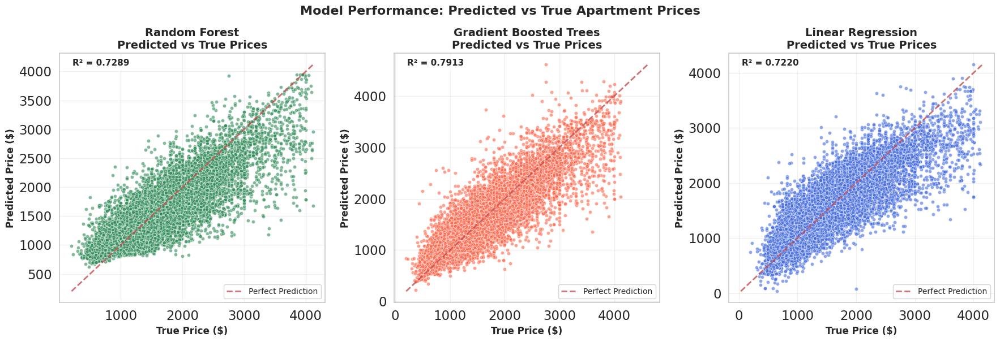


PREDICTION ACCURACY SUMMARY

Random Forest:
  • Mean Residual: $-3.54
  • Std Residual: $330.50
  • Min Prediction: $626.80
  • Max Prediction: $3,944.83
  • Prediction Range: $3,318.03

Gradient Boosted Trees:
  • Mean Residual: $-1.76
  • Std Residual: $290.00
  • Min Prediction: $226.12
  • Max Prediction: $4,608.01
  • Prediction Range: $4,381.89

Linear Regression:
  • Mean Residual: $-1.13
  • Std Residual: $334.68
  • Min Prediction: $35.14
  • Max Prediction: $4,148.35
  • Prediction Range: $4,113.21


In [ ]:
# Graphing the outcomes
# Create 3 scatter plots: predicted vs true prices for each model
import matplotlib.pyplot as plt
import numpy as np
import builtins

# Convert Spark DataFrames to Pandas for plotting
rf_predictions_pd = rf_test_predictions.select("label", "prediction").toPandas()
gbt_predictions_pd = gbt_test_predictions.select("label", "prediction").toPandas()
lr_predictions_pd = lr_test_predictions.select("label", "prediction").toPandas()

# Create figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Colors for each model
colors = ['#2E8B57', '#FF6347', '#4169E1']  # Sea green, tomato, royal blue
model_data = [
    (rf_predictions_pd, "Random Forest", colors[0]),
    (gbt_predictions_pd, "Gradient Boosted Trees", colors[1]),
    (lr_predictions_pd, "Linear Regression", colors[2])
]

# Create scatter plots
for i, (data, model_name, color) in enumerate(model_data):
    ax = axes[i]

    # Create scatter plot
    ax.scatter(data['label'], data['prediction'],
              alpha=0.6, s=20, color=color, edgecolors='white', linewidth=0.5)

    # Add perfect prediction line (y=x)
    min_val = builtins.min(data['label'].min(), data['prediction'].min())
    max_val = builtins.max(data['label'].max(), data['prediction'].max())
    ax.plot([min_val, max_val], [min_val, max_val],
           'r--', linewidth=2, alpha=0.8, label='Perfect Prediction')

    # Formatting
    ax.set_xlabel('True Price ($)', fontsize=12, fontweight='bold')
    ax.set_ylabel('Predicted Price ($)', fontsize=12, fontweight='bold')
    ax.set_title(f'{model_name}\nPredicted vs True Prices', fontsize=14, fontweight='bold')
    ax.grid(True, alpha=0.3)
    ax.legend(fontsize=10)

    # Add R² annotation
    if model_name == "Random Forest":
        r2_value = performance_df_rf.loc[performance_df_rf['Metric'] == 'R²', 'Test'].values[0]
    elif model_name == "Gradient Boosted Trees":
        r2_value = performance_df_gbt.loc[performance_df_gbt['Metric'] == 'R²', 'Test'].values[0]
    else:  # Linear Regression
        r2_value = performance_df_lr.loc[performance_df_lr['Metric'] == 'R²', 'Test'].values[0]

    ax.text(0.05, 0.95, f'R² = {r2_value}', transform=ax.transAxes,
           fontsize=11, fontweight='bold',
           bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

# Adjust layout and show
plt.tight_layout()
plt.suptitle('Model Performance: Predicted vs True Apartment Prices',
             fontsize=16, fontweight='bold', y=1.02)
plt.show()

# Print summary statistics for each model
print("\n" + "="*80)
print("PREDICTION ACCURACY SUMMARY")
print("="*80)

for data, model_name, _ in model_data:
    # Calculate additional metrics
    residuals = data['prediction'] - data['label']
    mean_residual = np.mean(residuals)
    std_residual = np.std(residuals)

    print(f"\n{model_name}:")
    print(f"  • Mean Residual: ${mean_residual:,.2f}")
    print(f"  • Std Residual: ${std_residual:,.2f}")
    print(f"  • Min Prediction: ${data['prediction'].min():,.2f}")
    print(f"  • Max Prediction: ${data['prediction'].max():,.2f}")
    print(f"  • Prediction Range: ${data['prediction'].max() - data['prediction'].min():,.2f}")

## Evaluation
- Gradient Boosted Trees performed the best overall with the highest R² score with the lowest MAE and RMSE
- Random Forest performed well but not as well as Gradient Boosted Trees
- Linear Regression performed the worst compared to the other two models

## Comparison of models

### Training Time 
**Linear Regression**: Despite the fact that the grid search space for the linear regression was the largest compared to the three models, it still was the easiest and fastest to train. This is likely because it is the simplest model out of the three and assumes linear relationships. It however, performed the worst as it is unable to capture non-linear relationships in the apartment rental data.  

**Random Forest**: Random Forest performed better than the linear regressor as it is able to capture non-linear relationships and feature interactions through its ensemble of decision trees. However, it required more computational resources and training time due to building multiple trees all of which are meant to be good learners/models (150 trees in our hyperparameter grid). The model generalized better than the linear regressor but was outperformed by GBT.  

**Gradient Boosted Trees**: GBT achieved the best performance but required the longest training time among all models. This is because it builds trees sequentially, with each tree learning from the errors of previous trees. The boosting process is computationally intensive but results in superior predictive accuracy. The model effectively captured complex patterns in the apartment rental data.  

### Model Characteristics

**Feature Scaling Requirements**:
- Linear Regression required scaled features for optimal performance
- Tree-based models (RF and GBT) worked directly with original features without scaling

**Overfitting Resistance**:
- Linear Regression: Regularization (L1/L2) helped prevent overfitting
- Random Forest: Bootstrap sampling and feature randomness provided natural overfitting protection  
- GBT: Required careful tuning of learning rate and tree depth to avoid overfitting

**Interpretability**:
- Linear Regression: Most interpretable with clear coefficient meanings
- Random Forest: Moderate interpretability through feature importance
- GBT: Least interpretable due to complex sequential tree interactions

### Why Ensemble Methods Outperformed Linear Regression

The apartment rental dataset contains complex, non-linear relationships between features that Linear Regression cannot capture due to its linear assumption. Ensemble methods like Random Forest and GBT excel at:

1. **Capturing Non-linear Patterns**: Tree-based models naturally handle non-linear relationships
2. **Feature Interactions**: Automatically detect interactions between features (e.g., bedrooms × bathrooms)
3. **Handling Mixed Data Types**: Effectively process both categorical and numerical features
4. **Robustness to Outliers**: Tree splits are less sensitive to extreme values

The sequential learning approach in GBT, where each tree corrects previous errors, made it particularly effective for this regression task, achieving the highest R² score.

In [136]:
# Export notebook to PDF
!jupyter nbconvert --to pdf --output-dir="./deliverables/" --output "leap-csci316-task2" Leap_Assignment2_Task2.ipynb

[NbConvertApp] Converting notebook Leap_Assignment2_Task2.ipynb to pdf
/opt/conda/share/jupyter/nbconvert/templates/latex/display_priority.j2:32: UserWarning: Your element with mimetype(s) dict_keys(['application/vnd.plotly.v1+json']) is not able to be represented.
  ((*- endblock -*))
[NbConvertApp] Support files will be in leap-csci316-task2_files/
[NbConvertApp] Making directory ./leap-csci316-task2_files
[NbConvertApp] Writing 251005 bytes to notebook.tex
[NbConvertApp] Building PDF
[NbConvertApp] Running xelatex 3 times: ['xelatex', 'notebook.tex', '-quiet']
[NbConvertApp] Running bibtex 1 time: ['bibtex', 'notebook']
[NbConvertApp] WARNING | bibtex had problems, most likely because there were no citations
[NbConvertApp] PDF successfully created
[NbConvertApp] Writing 1460809 bytes to deliverables/leap-csci316-task2.pdf
